# Echo cancelling

In this assignment you will be asked to implement several flavours of convolution and implement a couple of basic acoustic echo cancelling (AEC) algorithms.

This assigment does not require extensive computations.

## Plan:
1. Convolution in waveform and frequency domains \[1 point\]
2. Waveform domain LMS \[1 point\]
3. Spectral domain LMS \[1 point\]
4. Convolution in time-frequency domain \[2 points: this guy is hard\]

## Info
This task includes not only code, but theoretical questions, too. They are marked like "**YOUR ANSWER HERE**". Please, fill in your answers there.

## Sumbission:
Your submission should include:
1. The filled notebook
2. Outputs of your echo cancelling methods for both real and synthetic examples
3. Please, make a search by "YOUR ANSWER" to make sure you've found all the theoretical questions

## Downloading the data

Let's download it now and discuss it in the echo cancellong section.

In [1]:
from io import BytesIO
import os
import requests
from urllib.parse import urlencode
from zipfile import ZipFile

base_url = 'https://cloud-api.yandex.net/v1/disk/public/resources/download?'
public_key = 'https://disk.yandex.ru/d/C-o9WtGaLt8xow'

final_url = base_url + urlencode(dict(public_key=public_key))
response = requests.get(final_url)
download_url = response.json()['href']
response = requests.get(download_url)

path_to_dataset = 'data/homework_vqe_2'    # Choose any appropriate local path

zipfile = ZipFile(BytesIO(response.content))
zipfile.extractall(path=path_to_dataset)

ROOT_DATA = os.path.join(path_to_dataset, "homework_2")

## Convolution in waveform domain \[0.5 pts\]

### Convolution

Discrete convolution is defined for discrete finite or infinite sequences $x = (x_0, x_1, ...)$, $h=(h_0,h_1,...)$ by:

$$(x * h)_k = \sum_{i+j=k}x_i h_j$$


Convolution can also be expressed in the operator form:

$$x * h = \sum_{t}x_t \cdot T^t h \text{, } t \text { spans all the valid values}$$,

where $T$ is the right shift operator, i.e.

$$\forall y=(y_0, y_1, ...) ~~ (Ty)_t = \left\{
  \begin{array}{ c l }
    y_{t-1} & \quad \textrm{if } t \geq 1 \\
    0                 & \quad \textrm{if } t=0
  \end{array}
\right.$$

and $T^t y$ means $T$ applied to $y$ $t$ times, i.e. $T^0 y=y$, $T^1 y=T(y)$, $T^2 y=T(T(y))$, etc.

Now we are going to implement convolution by definition and in the operator form. It is not the fastest way to calculate it but in this way we can experience how it works.

In [6]:
import os

path_to_dataset = 'data/homework_vqe_2'
ROOT_DATA = os.path.join(path_to_dataset, "homework_2")

First of all, let's prepare the inputs:

In [7]:
import os

import matplotlib.pyplot as plt
import numpy as np
import scipy.signal as sig
import soundfile as sf
from tqdm.auto import tqdm

In [8]:
rng = np.random.default_rng(seed=17)
RANDOM_SIGNAL = rng.uniform(-1, 1, 1600)
RANDOM_KERNEL = rng.uniform(-1, 1, 800)

This is how convolution is done in scipy, you could have seen it in previous assignments:

In [9]:
convolved_scipy = sig.convolve(RANDOM_SIGNAL, RANDOM_KERNEL)
print(len(RANDOM_SIGNAL), len(RANDOM_KERNEL), len(convolved_scipy))
assert len(convolved_scipy) == len(RANDOM_SIGNAL) + len(RANDOM_KERNEL) - 1

1600 800 2399


For finite-length signals $\text{len}(x * h) = \text{len}(x) + \text{len}(h) - 1$
Why? Please, try to explain it:

**YOUR ANSWER HERE**
When we do convolution of two finite-length signals we get as a result all possible ways the two signals can overlap, we go one sequence through other. First, we start with only one sample overlap with kernel and continue until both sequences are fully overlapping, so for this actions from left to right we need len(x) + len(h) -1 steps

In [10]:
def convolve_by_definition(x: np.ndarray, h: np.ndarray) -> np.ndarray:
    assert x.ndim == h.ndim == 1, (x.shape, h.shape)
    result = np.zeros(len(x) + len(h) - 1)
    for out_idx in tqdm(range(len(result))):
        x_idx_min = max(0,  out_idx - (len(h) - 1))
        x_idx_max = min(len(x) - 1, out_idx)
        for x_idx in range(x_idx_min, x_idx_max + 1):
            h_idx =  out_idx - x_idx
            result[out_idx] += x[x_idx] * h[h_idx]
    return result


convolved = convolve_by_definition(RANDOM_SIGNAL, RANDOM_KERNEL)
diff = np.abs(convolved - convolved_scipy).max()
assert np.abs(diff) < 1e-10

100%|██████████| 2399/2399 [00:00<00:00, 4417.06it/s]


The inner cycle can be replaced with dot-product, just remember to flip the kernel part:

In [11]:
def convolve_dot_product(x: np.ndarray, h: np.ndarray) -> np.ndarray:
    assert x.ndim == h.ndim == 1, (x.shape, h.shape)
    result = np.zeros(len(x) + len(h) - 1)
    for out_idx in tqdm(range(len(result))):
        x_idx_min =  max(0, out_idx - (len(h) - 1))
        x_idx_max =  min(len(x) - 1, out_idx)

        h_idx_min =  out_idx - x_idx_max
        h_idx_max =  out_idx - x_idx_min

        x_crop = x[x_idx_min: x_idx_max + 1]
        h_crop = h[h_idx_min: h_idx_max + 1]

        h_crop_flipped = np.flip(h_crop)

        result[out_idx] = np.dot(x_crop, h_crop_flipped)
    return result

convolved = convolve_dot_product(RANDOM_SIGNAL, RANDOM_KERNEL)
diff = np.abs(convolved - convolved_scipy).max()
assert np.abs(diff) < 1e-10

100%|██████████| 2399/2399 [00:00<00:00, 168341.95it/s]


In [12]:
def convololve_operator_form(x: np.ndarray, h: np.ndarray) -> np.ndarray:
    assert x.ndim == h.ndim == 1, (x.shape, h.shape)
    result = np.zeros(len(x) + len(h) - 1)
    for x_idx in tqdm(range(len(x))):
        result[x_idx: x_idx + len(h)] +=  x[x_idx] * h
    return result


convolved = convololve_operator_form(RANDOM_SIGNAL, RANDOM_KERNEL)
diff = np.abs(convolved - convolved_scipy).max()
assert np.abs(diff) < 1e-10

100%|██████████| 1600/1600 [00:00<00:00, 183603.36it/s]


**Question:** what is the complexity asymptotics of direct convolution computation which you have implemented above?

**YOUR ANSWER HERE**  
Answer: O(len(x) * len(h)).   
convololve_operator_form: outer loop O(len(x)) and inside loop for mult and sum O(len(h)) -> O(len(x) * len(h))  
convolve_dot_product and convolve_by_definition: number of sum and mult is O(len(x) * len(h))

**Note:** What will happen if we zero-pad $x$ or $h$ in a convolution? It can be seen from the operator form: the output will be the same, but equally padded:

$$
\forall \text{ Zero-padding } P ~~~ x * P(h) = P(x) * h = P(x * h)
$$
Example:

In [13]:
left_padding = np.zeros(10)
right_padding = np.zeros(20)
h_padded = np.concatenate([left_padding, RANDOM_KERNEL, right_padding])
x_padded = np.concatenate([left_padding, RANDOM_SIGNAL, right_padding])

convolved_padded_kernel = sig.convolve(RANDOM_SIGNAL, h_padded)
convolved_padded_signal = sig.convolve(x_padded, RANDOM_KERNEL)

convolve_padded_result = np.concatenate([left_padding, convolved_scipy, right_padding])

assert np.abs(convolved_padded_kernel - convolve_padded_result).max() < 1e-10
assert np.abs(convolved_padded_signal - convolve_padded_result).max() < 1e-10

## Convolution in frequency domain \[0.5 pts\]

Let $\mathcal F$ denote **DFT, i.e. discrete Fourier transform**. Typically the **FFT, i.e. Fast Fourier Transform** algorithm is used to calculate DFT. FFT has a complexity asymptotics of $O(n \log n)$, while the naive DFT computation as matrix-vector multiplication has the complexity asymptotics of $(n^2)$, where $n$ is the size of an input. FFT is so popular that DFT is often referred to as FFT.

One of the properties of DFT is that it "turns convolution into multiplication":

$$x * h = \mathcal F^{-1} (\mathcal F(x) \cdot \mathcal F(h))$$

The equality holds true for mathematical reasons. However, we need to clarify what $\mathcal F$ means here. Let's take a closer look at that.

**This is how DFT and inverse DFT (IDFT) can be done in numpy.** Note that later we will exploit symmetry and use a better option:

In [14]:
x_dft = np.fft.fft(RANDOM_SIGNAL)
x_restored = np.fft.ifft(x_dft)

print(x_dft.shape, x_dft.dtype)

assert np.abs(x_restored - RANDOM_SIGNAL).max() < 1e-10

(1600,) complex128


DFT operates on complex numbers and preserves the size of its input. So we cannot just multiply the DFT's of $x$ and $h$.

But we have seen above that zero padding does not essentially modify the result of a convolution. Let's try to pad $h$ to the length of $x$ so that multiplication would become possible. Will our frequency domain convolution formula work now?

In [15]:
h_padded = np.concatenate([RANDOM_KERNEL, np.zeros(len(RANDOM_SIGNAL) - len(RANDOM_KERNEL))])
x_dft = np.fft.fft(RANDOM_SIGNAL)
h_dft = np.fft.fft(h_padded)

prod_dft = x_dft * h_dft

convolved_from_dft = np.fft.ifft(prod_dft)

print(convolved_scipy.shape, convolved_from_dft.shape)

(2399,) (1600,)


That doesn't work: the output shapes do not match!

Our naive spectral domain convolution output has the length equal to $\text{len}(x)$ while the real convolution output has the length of $\text{len}(x) + \text{len}(h) - 1$.

The spectral domain representation should be long enough to represent a sequence of length $\text{len}(x) + \text{len}(h) - 1$. So let's zero-pad both $x$ and $h$ to that size!

In [16]:
target_length = len(RANDOM_SIGNAL) + len(RANDOM_KERNEL) - 1
h_padded = np.concatenate([RANDOM_KERNEL, np.zeros(target_length - len(RANDOM_KERNEL))])
x_padded = np.concatenate([RANDOM_SIGNAL, np.zeros(target_length - len(RANDOM_SIGNAL))])
x_dft = np.fft.fft(x_padded)
h_dft = np.fft.fft(h_padded)
prod_dft =  x_dft * h_dft
convolved_from_dft = np.fft.ifft(prod_dft)

assert np.abs(convolved_from_dft - convolved_scipy).max() < 1e-10

It works, we did it!

Of course there is a mathematical proof behind it, but this is what we should remember when we do convolution in spectral domain in practice.

Technically the output is complex with a very small imaginary part:

In [17]:
print(convolved_from_dft.dtype, np.abs(convolved_from_dft.imag).max())

complex128 1.662558979376172e-14


But for real-values inputs, DFT features a symmetry:

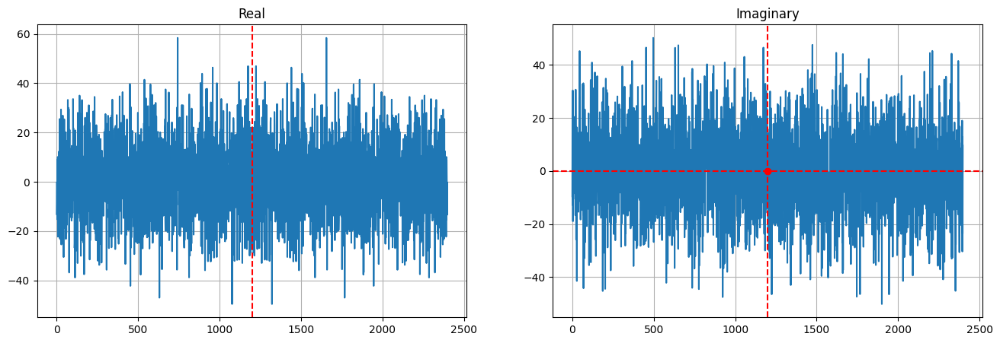

In [18]:
_, axes = plt.subplots(ncols=2, figsize=(16, 5))

sym_pt = (len(x_dft) - 2) / 2

ax = axes[0]
ax.set_title("Real")
vals = x_dft[1:].real
ax.plot(vals)
ax.axvline(sym_pt, color="red", linestyle="--")
ax.grid()

ax = axes[1]
vals = x_dft[1:].imag
ax.set_title("Imaginary")
ax.plot(vals)
ax.plot(sym_pt, 0, "ro")
ax.axvline(sym_pt, color="red", linestyle="--")
ax.axhline(0, color="red", linestyle="--")
ax.grid()

plt.show()

The real part features an axial symmetry, the imaginary part features point symmetry (greetings the first lectutre!):

In [19]:
assert np.abs(x_dft[1:].real - np.flip(x_dft[1:]).real).max() < 1e-10
assert np.abs(x_dft[1:].imag + np.flip(x_dft[1:]).imag).max() < 1e-10

Why do we truncate-out the 0-th element? It is just the sum of elements in $x$:

In [20]:
x_dft[0], np.sum(RANDOM_SIGNAL)

((-21.757712427274924+5.329070518200751e-15j), -21.75771242727492)

Thanks to the symmetry we can drop half of the elements of complex fft. Numpy and PyTorch provide such an option. In "rfft" "r" stands for "real".

It is more convenient to have lengths divisible by 2 here which can always be achieved by a small padding:

In [21]:
target_length = len(RANDOM_SIGNAL) + len(RANDOM_KERNEL) - 1
if target_length % 2 == 1:
    target_length_even = target_length + 1
else:
    target_length_even = target_length
h_padded = np.concatenate([RANDOM_KERNEL, np.zeros(target_length_even - len(RANDOM_KERNEL))])
x_padded = np.concatenate([RANDOM_SIGNAL, np.zeros(target_length_even - len(RANDOM_SIGNAL))])

x_dft_re = np.fft.rfft(x_padded)
h_dft_re = np.fft.rfft(h_padded)
prod_dft = x_dft_re * h_dft_re
convolved_from_dft = np.fft.irfft(prod_dft)

assert np.abs(convolved_from_dft[:target_length] - convolved_scipy).max() < 1e-10

### Convolution in PyTorch

In the future echo cancelling sections we are going to run gradient descent, differentiating through convolution.
We can calculate the gradients manually, however it is not a goal of this task.
So, let's use PyTorch for gradient calculation. For that we need to understand how to implement a regular convolution in PyTorch

In [22]:
import torch
import torch.nn as nn
import torch.nn.functional as F

Convolution in PyTorch requires:
- *batch* and *channel* dimensions for the signal
- *in_channels* and *out_channels* dimensions for the kernel.
For a regular convolution of 1D signals all those channels sizes should be set to 1.
PyTorch makes a convolution with the "valid" mode, the mode is controlled by padding.

Let's try and see what we get:

In [23]:
x_pt = torch.from_numpy(RANDOM_SIGNAL).reshape(1, 1, -1)
h_pt = torch.from_numpy(RANDOM_KERNEL).reshape(1, 1, -1)

convolved_from_pt = F.conv1d(x_pt, h_pt).reshape(-1).numpy()
convolved_scipy_valid = sig.convolve(RANDOM_SIGNAL, RANDOM_KERNEL, mode="valid")

print("difference:", np.square(convolved_from_pt - convolved_scipy_valid).mean())

difference: 172.76007523611833


Pretty bad, isn't it? We missed one detail.

PyTorch defines convolution primarily for neural network training. If we want to match the mathematical definition of convolution in PyTorch, we should flip the kernel.

In [24]:
def convolve_pt(x: torch.Tensor, h: torch.tensor, mode: str = "valid"):
    assert x.ndim in [1, 3], x.shape
    assert h.ndim in [1, 3], h.shape
    if x.ndim != 3:
        x = x.reshape(1, 1, -1)
    if h.ndim != 3:
        h = h.reshape(1, 1, -1)
    h =  torch.flip(h, dims=[-1])
    if mode == "full":
        x = F.pad(x, pad=[h.shape[-1] - 1] * 2)
    else:
        assert mode == "valid", mode
    result = F.conv1d(x, h).reshape(-1)
    return result


for mode in ["full", "valid"]:
    convolved_from_pt = convolve_pt(
        torch.from_numpy(RANDOM_SIGNAL),
        torch.from_numpy(RANDOM_KERNEL),
        mode,
    ).numpy()
    ref = sig.convolve(RANDOM_SIGNAL, RANDOM_KERNEL, mode=mode)
    diff = np.square(convolved_from_pt - ref).mean()
    print(f"Mode: {mode}", ", difference:", diff)
    assert diff < 1e-10, diff

Mode: full , difference: 4.697645934361218e-29
Mode: valid , difference: 2.760167201742164e-29


## Echo cancelling as it is

In echo cancelling we are provided the signal on a mic $y$, and the reference signal $s$ which was played by the speaker. The goal is to restore the near-end signal $n$ i.e. the sound on the mic which did not originate from the speaker.

The sound on the mic, originating from the speaker is called echo, let's denote is as $e$.

Similar to noise reduction:
$y = e + n$

We will make the following assmuptions:
1. $y = s * h + n$: the acoustics is linear, the loudspeaker and the microphone are ideal
2. $n$ and $e$ are uncorrelated

### Data

We will use 2 sets of files: one is fully real, the other one is a mixture of a real echo with clean speech and thus we call it synthetic.

Echo was captured from a laptop by simultaneous play of a known audio file and recording. The played file is used as reference, the microphone and reference channels were aligned manually.

For the real mixture a video was played on a smartphone simultaneously and it represents the near-end speech we aim to restore.

Why do we use a synthetic mixture when we have a real file? We need an access to the near-end and echo channels for evaluation, and those are only available for synthetic files.

Please, take your time to listen to the files.

In [25]:
SR = 16_000


def read_wav(path) -> np.ndarray:
    x, sr = sf.read(path)
    assert sr == SR, (path, sr)
    return x


DATA = {
    "real": {
        "mic": read_wav(os.path.join(ROOT_DATA, "real/mic.wav")),
        "ref": read_wav(os.path.join(ROOT_DATA, "real/ref.wav")),
        "near_end": None,
        "echo": None,
    },
    "synth": {
        "mic": read_wav(os.path.join(ROOT_DATA, "synth/mic.wav")),
        "ref": read_wav(os.path.join(ROOT_DATA, "synth/ref.wav")),
        "near_end": read_wav(os.path.join(ROOT_DATA, "synth/near.wav")),
    }
}

for key in ["synth"]:
    DATA[key]["echo"] = DATA[key]["mic"] - DATA[key]["near_end"]

### Waveform Domain  LMS \[0.5 pt\]:

LMS stands for least mean squares.
For AEC we are given:
- $y \in \mathbb R^T$: signal on the mic
- $s \in \mathbb R^T$: signal on the speaker, also referred to as reference

Least mean squares solves finds the impulse response $\hat h$ which minimizes the following expression:

$$\hat h = \underset{h}{\operatorname{argmin}} ||y - s * h||_2 = \underset{h}{\operatorname{argmin}} \frac{1}{T}\sum_{t=0}^{T-1}(y_t - (s * h)_t)^2$$

With $\hat h$ we can estimate echo: $\hat e = s * \hat h$ and the near-end signal: $\hat n = y - \hat e$.

Wait, but the size of $s*h$ should be
$\text{len}(s) + \text{len}(h) - 1 > \text{len}(s)$ if $\text{len}(h)>1$!

It's ok, we ignore the last $\text{len}(h) - 1$ samples of $s * h$. Why? Because we only need to suppress the echo, e.g. during a call of given length $T$.

**We'll use gradient descent for this task**

In [26]:
class Convolution(nn.Module):
    """
    This class will be used to find the convolutional kernel
    (a.k.a. room impulse response) by gradient descent.

    Instead of flipping the kernel on each self.forward
    we will use the PyTorch-style convolution in self.forward
    and flip the PyTorch-style kernel when we will need to access the classical kernel.
    """
    def __init__(self, kernel_size: int) -> None:
        super().__init__()
        self.padding = nn.ConstantPad1d([kernel_size - 1, 0], 0)
        self.conv = nn.Conv1d(1, 1, kernel_size, bias=False)
        nn.init.zeros_(self.conv.weight)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        assert x.ndim == 3, x.shape
        # your code: apply self.padding and self.conv
        result = self.conv(self.padding(x))
        assert result.shape == x.shape, (result.shape, x.shape)
        return result

    @torch.no_grad()
    def apply(self, x: np.ndarray) -> np.ndarray:
        """
        Like self.forward, but for 1-D np.ndarrays
        """
        assert x.ndim == 1, x.shape
        x = torch.tensor(x, dtype=self.conv.weight.dtype, device=self.conv.weight.device)
        x = x.reshape(1, 1, -1)
        result = self.forward(x)
        result = result[0, 0].cpu().numpy()
        return result

    def get_kernel(self) -> np.ndarray:
        """
        Transforms the convolutional kernel from PyTorch respresentation
        to the classical one.
        """
        return torch.flip(self.conv.weight.data[0, 0], [-1]).detach().cpu().numpy()

    def set_kernel(self, kernel: np.ndarray) -> None:
        kernel_cur = self.conv.weight
        kernel = torch.tensor(kernel, dtype=kernel_cur.dtype, device=kernel_cur.device)
        assert kernel.ndim == 1, kernel.shape
        assert len(kernel) == kernel_cur.shape[-1], (len(kernel), kernel_cur.shape)
        kernel = torch.flip(kernel, [-1]).reshape(1, 1, -1)
        self.conv.weight.data = kernel


with torch.no_grad():
    conv = Convolution(len(RANDOM_KERNEL))
    conv.set_kernel(torch.tensor(RANDOM_KERNEL, dtype=torch.float))

    x_pt = torch.tensor(RANDOM_SIGNAL, dtype=torch.float).reshape(1, 1, -1)
    convolved = conv(x_pt).squeeze()
    diff = np.abs(convolved.numpy() - convolved_scipy[:len(convolved)]).mean()
    assert diff < 1e-5
    print("shapes:", convolved.shape, RANDOM_SIGNAL.shape)

    convolved = conv.apply(RANDOM_SIGNAL)
    diff = np.abs(convolved - convolved_scipy[:len(convolved)]).mean()
    assert diff < 1e-5
    print("shapes:", convolved.shape, RANDOM_SIGNAL.shape)

shapes: torch.Size([1600]) (1600,)
shapes: (1600,) (1600,)


/tmp/ipykernel_3339/1248497568.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  kernel = torch.tensor(kernel, dtype=kernel_cur.dtype, device=kernel_cur.device)


In [27]:
# %pip install torchmetrics

In [28]:
from torchmetrics.audio import SignalNoiseRatio
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

/home/jupyter/.local/lib/python3.10/site-packages/transformers/utils/hub.py:106: FutureWarning: Using `TRANSFORMERS_CACHE` is deprecated and will be removed in v5 of Transformers. Use `HF_HOME` instead.
  warnings.warn(


In [29]:
def fit_waveform_lms(
    mic: np.ndarray,
    ref: np.ndarray,
    echo: np.ndarray | None = None,
    near_end: np.ndarray | None = None,
    verbose=False
):
    """
    Fits Waveform-domain LMS for mic and ref and calculates metrics during training.

    Echo and near_end are unavailable in practice and should only be used for metrics calculation
    If not provided, echo will be replaced by mic, near_end will be replaced by zeros
    verbose may be useful for debug
    """
    n_steps = 1_500
    kernel_size_frames = int(0.25 * SR)
    conv = Convolution(kernel_size_frames).to(device)
    opt = torch.optim.Adam(conv.parameters(), lr=1e-2, weight_decay=0)

    if echo is None:
        echo = mic
    if near_end is None:
        near_end = np.zeros_like(mic)

    mic_pt = torch.tensor(mic, dtype=torch.float, device=device).reshape(1, 1, -1)
    ref_pt = torch.tensor(ref, dtype=torch.float, device=device).reshape(1, 1, -1)

    echo_pt = torch.tensor(echo, dtype=torch.float, device=device).reshape(1, 1, -1)
    near_end_pt = torch.tensor(near_end, dtype=torch.float, device=device).reshape(1, 1, -1)

    criterion = nn.MSELoss().to(device)
    snr_evaluator = SignalNoiseRatio().to(device)

    logs = []

    best_loss = None
    best_loss_snapshot = None

    for idx in tqdm(range(n_steps)):
        echo_est = conv(ref_pt)
        loss =  criterion(echo_est, mic_pt)
        opt.zero_grad()
        loss.backward()
        opt.step()

        # saving the best fit
        if best_loss is None or loss < best_loss:
            best_loss = loss.item()
            best_loss_snapshot = conv.state_dict()

        with torch.no_grad():
            loss_oracle =  criterion(echo_est, echo_pt) # your code: calculate the loss using echo_pt as ground truth
            snr_echo = snr_evaluator(echo_est, echo_pt)  # your code: calculate SNR between echo_est and echo_pt
            near_end_est = mic_pt - echo_est # your code: calculate as the difference of mic and echo_est
            snr_near = snr_evaluator(near_end_est, near_end_pt)  # your code: calculate SNR between near_end_est and near_end_pt

        logs.append(
            {
                "loss": loss.item(),
                "loss_oracle": loss_oracle.item(),
                "snr_echo": snr_echo.item(),
                "snr_near": snr_near.item(),
                "lr": opt.param_groups[0]["lr"],
            }
        )

        if verbose and (idx % 100 == 0 or idx + 1 == n_steps):
            print(logs[-1])

    # loading the best snapshot
    final_model = Convolution(kernel_size_frames).to(device)
    final_model.load_state_dict(best_loss_snapshot)
    return final_model, logs

In [30]:
ALL_LOGS = {}
ALL_LOGS["waveform_lms"] = {}

In [31]:
convolution, logs = fit_waveform_lms(**DATA["synth"])
ALL_LOGS["waveform_lms"]["synth"] = (convolution.cpu(), logs)

100%|██████████| 1500/1500 [08:03<00:00,  3.10it/s]


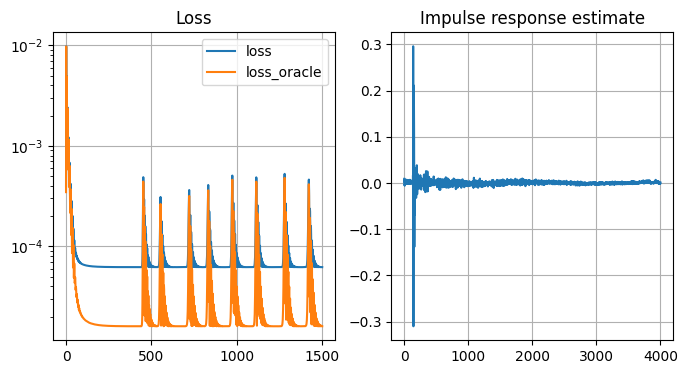

In [32]:
_, axes = plt.subplots(ncols=2, figsize=(8, 4))

ax = axes[0]
ax.set_title("Loss")
for key in ["loss", "loss_oracle"]:
    ax.plot([x[key] for x in logs], label=key)
ax.grid()
ax.legend()
ax.set_yscale("log")

ax = axes[1]
ax.set_title("Impulse response estimate")
ax.plot(convolution.get_kernel())
ax.grid()

plt.show()

**Question:** Is loss_oracle lower than loss? Why? Please, comment on the stability of the training procedure.  
As we can see from the graph loss_oracle is lower than loss. It is because loss_oracle is MSE between gt echo and predicted, but loss is MSE between predicted echo and gt mic signal ($y = s * h + n$), near-end in addiction, so oracle_loss is lower because we compare only echo.  
In general training is stable, but there are some large drops in losses. It can be because of the behaviour of the optimizer

**YOUR ANSWER HERE**

In [33]:
# some useful methods

from scipy import signal
from scipy.io import wavfile
import IPython.display as ipd
import os

def calculate_metrics(mic, echo, near_end, output, echo_estimate):
    echo_power = np.mean(echo**2) + 1e-10
    error_power = np.mean((echo - echo_estimate)**2) + 1e-10
    erle = 10 * np.log10(echo_power / error_power)

    if np.any(near_end):
        signal_power = np.mean(near_end**2) + 1e-10
        noise_power = np.mean((near_end - output)**2) + 1e-10
        snr = 10 * np.log10(signal_power / noise_power)
    else:
        snr = float("inf")

    echo_norm = np.sum(echo**2) + 1e-10
    error_norm = np.sum((echo - echo_estimate)**2) + 1e-10
    misalignment = 10 * np.log10(error_norm / echo_norm)

    return {
        "ERLE": erle,
        "SNR": snr,
        "Misalignment": misalignment
    }


def plot_impulse_response(impulse_response):
    """Визуализация импульсного отклика фильтра"""
    plt.figure(figsize=(10, 6))
    plt.subplot(2, 1, 1)
    plt.plot(impulse_response)
    plt.title("Impulse response")
    plt.xlabel("Position")
    plt.ylabel("Amplitude")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

def plot_results(mic, ref, near_end, echo, output, echo_estimate, use_spectral=False, fs=16000):
    tmp_dir = 'tmp_audio'
    if not os.path.exists(tmp_dir):
        os.makedirs(tmp_dir)

    wavfile.write(f"{tmp_dir}/mic.wav", fs, mic.astype(np.float32))
    wavfile.write(f"{tmp_dir}/ref.wav", fs, ref.astype(np.float32))
    wavfile.write(f"{tmp_dir}/near_end.wav", fs, near_end.astype(np.float32))
    wavfile.write(f"{tmp_dir}/echo.wav", fs, echo.astype(np.float32))
    wavfile.write(f"{tmp_dir}/output.wav", fs, output.astype(np.float32))
    wavfile.write(f"{tmp_dir}/echo_estimate.wav", fs, echo_estimate.astype(np.float32))

    if use_spectral:
        num_rows = 8
        plt.figure(figsize=(15, 20))
    else:
        num_rows = 4
        plt.figure(figsize=(15, 12))

    print("mic (echo + speech):")
    display(ipd.Audio(f"{tmp_dir}/mic.wav"))

    print("ref (far end):")
    display(ipd.Audio(f"{tmp_dir}/ref.wav"))

    print("near end")
    display(ipd.Audio(f"{tmp_dir}/near_end.wav"))

    print("echo")
    display(ipd.Audio(f"{tmp_dir}/echo.wav"))

    print("near end est.")
    display(ipd.Audio(f"{tmp_dir}/output.wav"))

    print("echo est")
    display(ipd.Audio(f"{tmp_dir}/echo_estimate.wav"))

    def plot_spectrogram(signal_data, ax, title):
        f, t, Sxx = signal.spectrogram(signal_data, fs=fs, nperseg=1024, noverlap=512)
        im = ax.pcolormesh(t, f, 10 * np.log10(Sxx + 1e-10), shading='gouraud', cmap='viridis')
        ax.set_ylabel('Frequency [Hz]')
        ax.set_xlabel('Time [sec]')
        ax.set_title(title)
        plt.colorbar(im, ax=ax, label='Magnitude [dB]')

    plt.subplot(num_rows, 1, 1)
    plt.plot(mic, label="Mic (echo + near_end)")
    plt.plot(ref, label="Reference")
    plt.plot(near_end, label="Near end")
    plt.legend()
    plt.title("Input signals")
    plt.grid(True)

    if use_spectral:
        ax = plt.subplot(num_rows, 1, 2)
        plot_spectrogram(mic, ax, "Spectrogram of Mic signal")

    plt.subplot(num_rows, 1, 3 if use_spectral else 2)
    plt.plot(echo_estimate, label="Estimated echo")
    plt.plot(echo, label="Real echo")
    plt.legend()
    plt.title("Echo signals")
    plt.grid(True)

    if use_spectral:
        ax = plt.subplot(num_rows, 1, 4)
        plot_spectrogram(echo, ax, "Spectrogram of Real echo")

        ax = plt.subplot(num_rows, 1, 5)
        plot_spectrogram(echo_estimate, ax, "Spectrogram of Estimated echo")

    plt.subplot(num_rows, 1, 6 if use_spectral else 3)
    plt.plot(output, label="Output signal (Estimated near-end)")
    plt.plot(near_end, label="True near-end")
    plt.legend()
    plt.title("Output signal")
    plt.grid(True)

    if use_spectral:
        ax = plt.subplot(num_rows, 1, 7)
        plot_spectrogram(near_end, ax, "Spectrogram of True near-end")

        ax = plt.subplot(num_rows, 1, 8)
        plot_spectrogram(output, ax, "Spectrogram of Output signal")

    plt.tight_layout()
    plt.show()

    if use_spectral:
        plt.figure(figsize=(15, 10))

        plt.subplot(2, 1, 1)
        f_echo, t_echo, Sxx_echo = signal.spectrogram(echo, fs=fs, nperseg=1024, noverlap=512)
        f_echo_est, t_echo_est, Sxx_echo_est = signal.spectrogram(echo_estimate, fs=fs, nperseg=1024, noverlap=512)

        min_t = min(len(t_echo), len(t_echo_est))
        min_f = min(len(f_echo), len(f_echo_est))

        diff_echo = 10 * np.log10(Sxx_echo[:min_f, :min_t] + 1e-10) - 10 * np.log10(Sxx_echo_est[:min_f, :min_t] + 1e-10)
        im = plt.pcolormesh(t_echo[:min_t], f_echo[:min_f], diff_echo, cmap='coolwarm', shading='gouraud')
        plt.colorbar(im, label='Magnitude difference [dB]')
        plt.title('Spectral difference: Real echo - Estimated echo')
        plt.ylabel('Frequency [Hz]')
        plt.xlabel('Time [sec]')

        plt.subplot(2, 1, 2)
        f_near, t_near, Sxx_near = signal.spectrogram(near_end, fs=fs, nperseg=1024, noverlap=512)
        f_out, t_out, Sxx_out = signal.spectrogram(output, fs=fs, nperseg=1024, noverlap=512)

        min_t = min(len(t_near), len(t_out))
        min_f = min(len(f_near), len(f_out))

        diff_near = 10 * np.log10(Sxx_near[:min_f, :min_t] + 1e-10) - 10 * np.log10(Sxx_out[:min_f, :min_t] + 1e-10)
        im = plt.pcolormesh(t_near[:min_t], f_near[:min_f], diff_near, cmap='coolwarm', shading='gouraud')
        plt.colorbar(im, label='Magnitude difference [dB]')
        plt.title('Spectral difference: True near-end - Estimated near-end')
        plt.ylabel('Frequency [Hz]')
        plt.xlabel('Time [sec]')

        plt.tight_layout()
        plt.show()

### Streaming waveform domain  LMS \[0.5 pt\]:

The adaptive LMS filter updates the estimate $h$ as new data arrives (streaming/online). Assume a filter of length $L$ ($h = [h_0, ..., h_{L-1}]^\top$).

At each step $t$:
- Form a vector of the latest $L$ values of $s$:
  $$
  \mathbf{s}_t = [s_t, s_{t-1}, ..., s_{t-L+1}]^\top
  $$
  (use zero-padding for $t-k < 0$)
- Estimate the echo at time $t$:
  $$
  \hat e_t = \mathbf{s}_t^\top h
  $$
- Compute the error:
  $$
  e_t = y_t - \hat e_t
  $$
- LMS update:
  $$
  h \leftarrow h + \eta\, e_t\, \mathbf{s}_t
  $$
  where $\eta$ is the learning rate.

#### NLMS (Normalized LMS)

NLMS is a modification of LMS, normalizing the step by the energy of the input vector:
$$
h \leftarrow h + \frac{\eta}{\| \mathbf{s}_t \|^2 + \epsilon} \, e_t\, \mathbf{s}_t
$$
where $\epsilon$ is a small constant to avoid division by zero.


In [94]:
from typing import Optional, Tuple, Union, Dict, List

def fit_waveform_streaming_lms(
    mic: np.ndarray,
    ref: np.ndarray,
    echo: np.ndarray = None,
    near_end: np.ndarray = None,
    filter_length: int = 512,
    mu: float = 0.1,
    normalize: bool = True,
    device: str = "cuda" if torch.cuda.is_available() else "cpu",
    verbose: bool = False
) -> Dict[str, Union[np.ndarray, Dict[str, float], List[float]]]:
    """
    Fits streaming Waveform-domain LMS for mic and ref and calculates metrics during training.

    Echo and near_end are unavailable in practice and should only be used for metrics calculation
    If not provided, echo will be replaced by mic, near_end will be replaced by zeros
    verbose may be useful for debug

    """
    if echo is None:
        echo = mic
    if near_end is None:
        near_end = np.zeros_like(mic)

    mic_pt = torch.tensor(mic, dtype=torch.float32, device=device).reshape(1, 1, -1)
    ref_pt = torch.tensor(ref, dtype=torch.float32, device=device).reshape(1, 1, -1)
    echo_pt = torch.tensor(echo, dtype=torch.float32, device=device).reshape(1, 1, -1)
    near_end_pt = torch.tensor(near_end, dtype=torch.float32, device=device).reshape(1, 1, -1)

    batch_size, channels, signal_length = mic_pt.shape
    signal_length = signal_length.item() if isinstance(signal_length, torch.Tensor) else signal_length

    filter_weights = torch.zeros(filter_length, device=device, dtype=torch.float32)

    final_estimated_echo = torch.zeros_like(mic_pt, dtype=torch.float32)
    final_output_signal = torch.zeros_like(mic_pt, dtype=torch.float32)

    estimated_echo = torch.zeros_like(mic_pt, dtype=torch.float32)
    output_signal = torch.zeros_like(mic_pt, dtype=torch.float32) # near end est.

    # LMS
    # ref_padded = torch.cat([torch.zeros(filter_length - 1, device=device), ref_pt[0, 0]])
    for n in tqdm(range(filter_length, signal_length), disable=not verbose):
        s_t = ref_pt[0, 0, n - filter_length + 1 : n + 1]
        s_t = torch.flip(s_t, dims=[0])
        echo_hat = torch.dot(s_t.T, filter_weights)
        estimated_echo[0, 0, n] = echo_hat
        
        error = mic_pt[0, 0, n] - echo_hat
        output_signal[0, 0, n] = error

        # NLMS
        if normalize:
            norm = s_t.norm() ** 2 + 1e-8
            filter_weights = filter_weights + mu / norm * error * s_t
        else:
            filter_weights = filter_weights + mu * error * s_t

    final_estimated_echo = estimated_echo
    final_output_signal = output_signal

    output_np = final_output_signal.cpu().numpy()[0, 0]
    echo_estimate_np = final_estimated_echo.cpu().numpy()[0, 0]

    impulse_response = filter_weights.cpu().numpy()

    metrics = calculate_metrics(mic, echo, near_end, output_np, echo_estimate_np)

    if verbose:
        plot_results(mic, ref, near_end, echo, output_np, echo_estimate_np)
        plot_impulse_response(impulse_response)

    return {
        "near_end_est": output_np,
        "echo_est": echo_estimate_np,
        "metrics": metrics,
        "impulse_response": impulse_response,
    }

100%|██████████| 112000/112000 [00:09<00:00, 11493.90it/s]


mic (echo + speech):


ref (far end):


near end


echo


near end est.


echo est


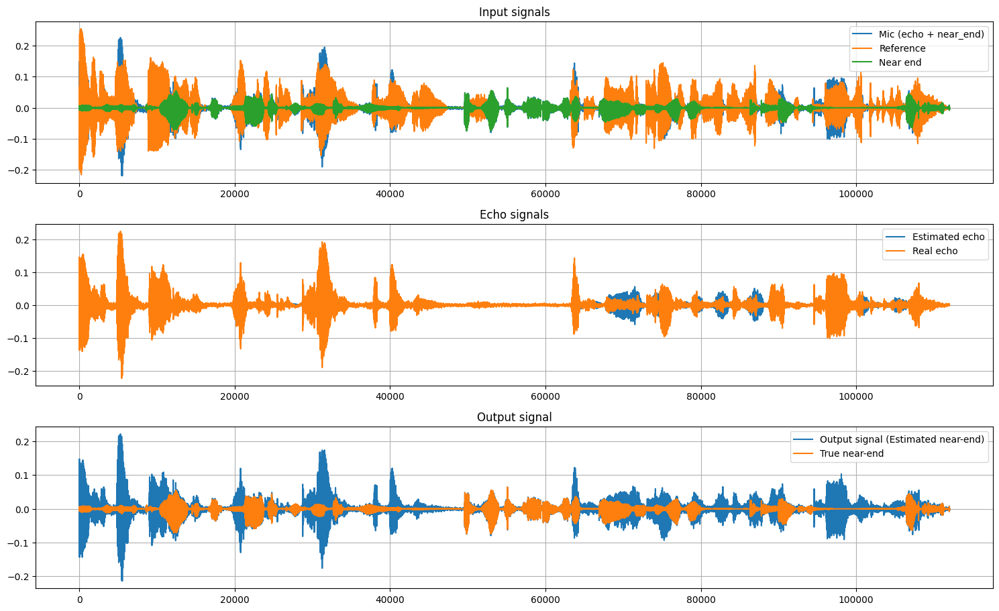

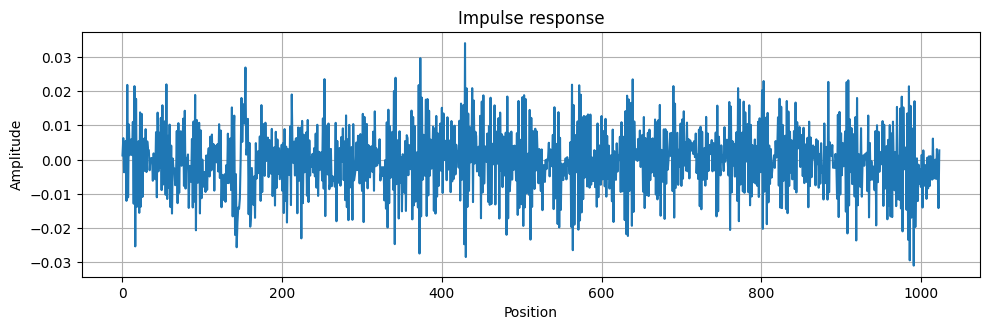

ERLE: 0.46 dB
SNR: -8.00 dB
Misalignment: -0.46 dB


In [95]:
adapt_vals_synth = fit_waveform_streaming_lms(
    filter_length=1024,
    mu=0.001,
    # mu=0.01,
    verbose=True,
    **DATA["synth"]
)
# Try your own params
metrics = adapt_vals_synth["metrics"]
print(f"ERLE: {metrics['ERLE']:.2f} dB")
print(f"SNR: {metrics['SNR']:.2f} dB")
print(f"Misalignment: {metrics['Misalignment']:.2f} dB")

**Task:** What can you say about RTF in a streaming implementation? Is it feasible to use streaming waveform LMS?

**YOUR ANSWER HERE**

100%|██████████| 110976/110976 [00:09<00:00, 11392.49it/s]


mic (echo + speech):


ref (far end):


near end


echo


near end est.


echo est


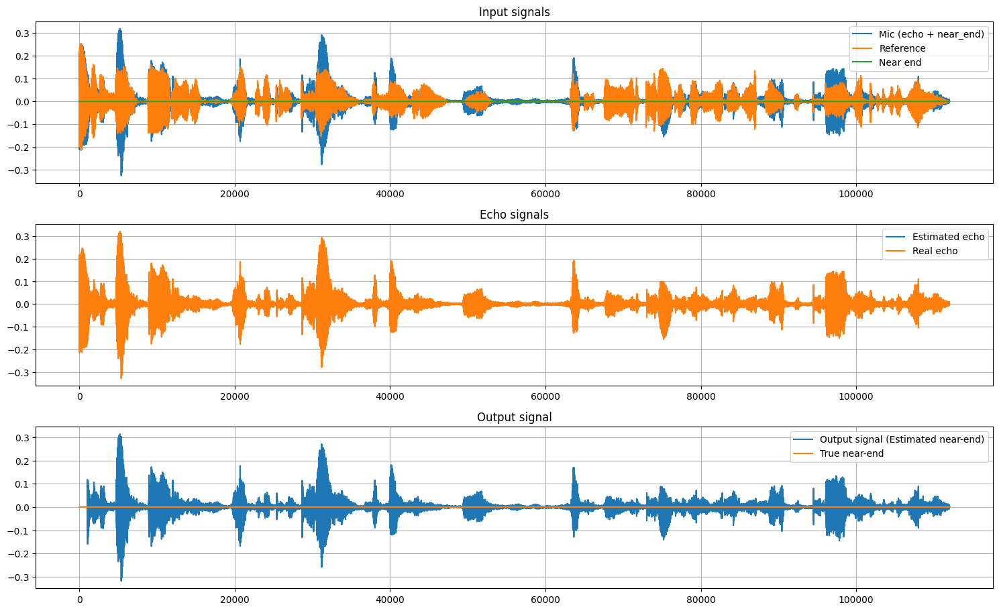

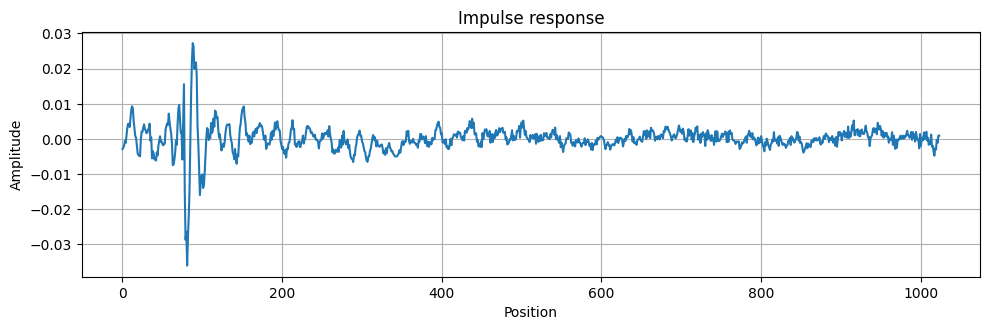

ERLE: 0.56 dB
SNR: inf dB
Misalignment: -0.56 dB


In [45]:
adapt_vals_real = fit_waveform_streaming_lms(
    filter_length=1024,
    mu=1e-3,
    verbose=True,
    **DATA["real"]
)
metrics_real = adapt_vals_real["metrics"]
print(f"ERLE: {metrics_real['ERLE']:.2f} dB")
print(f"SNR: {metrics_real['SNR']:.2f} dB")
print(f"Misalignment: {metrics_real['Misalignment']:.2f} dB")

Saving data for both LMS

In [46]:
ROOT_OUT = "data/output"  # your local path to save the files
data = DATA["synth"]
root_out = os.path.join(ROOT_OUT, "streaming_waveform_lms_synth")
os.makedirs(root_out, exist_ok=True)

sf.write(os.path.join(root_out, "near_end_est.wav"), adapt_vals_synth["near_end_est"], SR)
sf.write(os.path.join(root_out, "echo_est.wav"), adapt_vals_synth["echo_est"], SR)

for key in ["mic", "ref"]:
    sf.write(os.path.join(root_out, f"{key}.wav"), data[key], SR)

In [47]:
data = DATA["real"]
root_out = os.path.join(ROOT_OUT, "streaming_waveform_lms_real")
os.makedirs(root_out, exist_ok=True)

sf.write(os.path.join(root_out, "near_end_est.wav"), adapt_vals_real["near_end_est"], SR)
sf.write(os.path.join(root_out, "echo_est.wav"), adapt_vals_real["echo_est"], SR)

for key in ["mic", "ref"]:
    sf.write(os.path.join(root_out, f"{key}.wav"), data[key], SR)

In [48]:
data = DATA["synth"]
echo_est = convolution.apply(data["ref"])
near_end_est = data["mic"] - echo_est

root_out = os.path.join(ROOT_OUT, "waveform_lms_synth")
os.makedirs(root_out, exist_ok=True)

sf.write(os.path.join(root_out, "near_end_est.wav"),  near_end_est, SR)
for key in ["mic", "ref"]:
    sf.write(os.path.join(root_out, f"{key}.wav"),  data[key], SR)

100%|██████████| 1500/1500 [08:04<00:00,  3.10it/s]


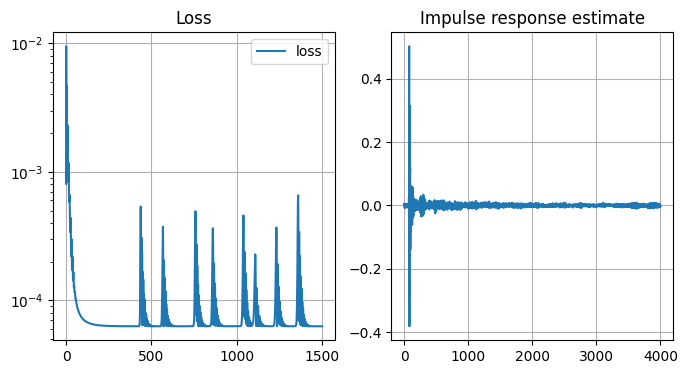

In [49]:
data_type = "real"
convolution, logs = fit_waveform_lms(**DATA[data_type])
ALL_LOGS["waveform_lms"][data_type] = (convolution.cpu(), logs)

_, axes = plt.subplots(ncols=2, figsize=(8, 4))

ax = axes[0]
ax.set_title("Loss")
for key in ["loss"]:  # "loss_oracle" does not make sense here
    ax.plot([x[key] for x in logs], label=key)
ax.grid()
ax.legend()
ax.set_yscale("log")

ax = axes[1]
ax.set_title("Impulse response estimate")
ax.plot(convolution.get_kernel())
ax.grid()

plt.show()


data = DATA[data_type]
echo_est = convolution.apply(data["ref"])
near_end_est = data["mic"] - echo_est

root_out = os.path.join(ROOT_OUT, f"waveform_lms_{data_type}")
os.makedirs(root_out, exist_ok=True)

sf.write(os.path.join(root_out, "near_end_est.wav"),  near_end_est, SR)
for key in ["mic", "ref"]:
    sf.write(os.path.join(root_out, f"{key}.wav"),  data[key], SR)

**Task:** Please, take a moment to listen to the output. What can you say about the quality of the methods?

**YOUR ANSWER HERE**

### Time-Frequency Domain LMS \[0.5 pt\]

Time-Frequency domain LMS is defined as follows:

$X = STFT(x)$, $Y = STFT(y)$

For each frequency f we find:

$$\hat h_f = \underset{h}{\operatorname{argmin}} ||T_f - S_f * h_f||_2 = \underset{h}{\operatorname{argmin}} \frac{1}{t}\sum_{\tau=0}^{t-1}|Y_{f,\tau} - (S_f * h_f)_\tau|^2$$

With $\hat h_f$ the complex spectrum of echo is estimated as $\hat E_f = S_f * \hat h_f$, the complex spectrum of the near-end signal is estimated as $\hat N_f = Y_f - \hat E_f$, and waveforms can be obtained by ISTFT.

Is there a theoretical basis for this approach? Yes, there is, and we will get down do it later in this assignment. However, this algorithm is still partly heuristical.

First, let's implement it.

In [51]:
class SpectralConvolution(nn.Module):
    """
    Applies parallel frequency-wise complex-valued convolutions.
    Makes use of groupped convolutions in PyTorch.
    """
    def __init__(self, n_freqs: int, kernel_size: int) -> None:
        super().__init__()
        convs = {}
        for mode in ["real", "imag"]:
            conv = nn.Sequential(
                nn.ConstantPad1d([kernel_size - 1, 0], 0),
                nn.Conv1d(n_freqs, n_freqs, kernel_size, groups=n_freqs, bias=False)
            )
            convs[mode] = conv
        self.convs = nn.ModuleDict(convs)
        for _, conv_layer in self.convs.values():
            nn.init.zeros_(conv_layer.weight)

    def forward(self, spec: torch.Tensor) -> torch.Tensor:
        assert spec.ndim == 3, spec.shape
        in_channels = {
            "real": torch.real(spec),
            "imag": torch.imag(spec),
        }
        out_real = self.convs["real"](in_channels["real"]) - self.convs["imag"](in_channels["imag"]) # your code: calculate the real part of the complex output
        out_imag = self.convs["real"](in_channels["imag"]) + self.convs["imag"](in_channels["real"]) # your code: calculate the imag part of the complex output
        result = out_real + 1j * out_imag
        return result

In [52]:
from torchaudio.transforms import Spectrogram, InverseSpectrogram


class EndToEndSpectralConvolution(nn.Module):
    """
    Combines stft, istft and SpectralConvolution
    """
    def __init__(self, kernel_size: int, n_fft=2048, win_length=None, **stft_kwargs):
        super().__init__()
        assert n_fft % 2 == 0, n_fft
        self.stft = Spectrogram(n_fft=n_fft, win_length=win_length, power=None, **stft_kwargs)
        self.istft = InverseSpectrogram(n_fft=n_fft, win_length=win_length, **stft_kwargs)
        self.conv = SpectralConvolution(n_freqs=n_fft // 2 + 1, kernel_size=kernel_size)

    def prepare_spectrogram(self, x: np.ndarray) -> torch.Tensor:
        """
        Builds a spectrogram which is suitable for self.conv.forward
        """
        assert x.ndim == 1, x.shape
        device = next(iter(self.parameters())).device
        dtype = next(iter(self.parameters())).dtype
        x = torch.tensor(x, device=device, dtype=dtype).reshape(1, -1)  # batch dim
        spec = self.stft(x)
        return spec

    @torch.no_grad()
    def apply(self, ref: np.ndarray) -> np.ndarray:
        """
        Estimates echo from 1-D np.ndarray waveforms
        """
        assert ref.ndim == 1, ref.shape
        target_length = ref.shape[-1]
        device = next(iter(self.parameters())).device
        dtype = next(iter(self.parameters())).dtype
        ref = torch.tensor(ref, device=device, dtype=dtype).reshape(1, -1)  # batch dim
        spec_ref = self.stft(ref)
        spec_echo_est = self.conv(spec_ref)
        echo_est_wave = self.istft(spec_echo_est, length=target_length)
        echo_est_wave_np = echo_est_wave[0].cpu().numpy()
        return echo_est_wave_np


end_to_end = EndToEndSpectralConvolution(kernel_size=15).to(device)
end_to_end.apply(data["ref"]).shape, data["ref"].shape

((112000,), (112000,))

In [53]:
class ComplexMse(nn.Module):
    def __init__(self):
        super().__init__()
        self.mse = nn.MSELoss()

    def forward(self, est: torch.Tensor, target: torch.Tensor) -> torch.Tensor:
        result = self.mse(torch.real(est), torch.real(target)) + self.mse(torch.imag(est), torch.imag(target))
        return result

Note: PyTorch natively supports complex-valued operations, you just need to remember to use absolute value when calculating losses for complex numbers.


In [58]:
def fit_spectral_lms(
    mic: np.ndarray,
    ref: np.ndarray,
    echo: np.ndarray | None = None,
    near_end: np.ndarray | None = None,
    loss_type: str = "spectral",  # "spectral" or "waveform",
    verbose: bool = False,  # helpful for debug
):
    """
    Fits time-frequency-domain LMS for mic and ref and calculates metrics during training.

    Echo and near_end are unavailable in practice and should only be used for metrics calculation
    If not provided, echo will be replaced by mic, near_end will be replaced by zeros

    loss_type: either STFT-domain MSE or waveform-domain MSE
    """
    n_steps = 1_500
    kernel_size = 15
    conv_kwargs = dict(kernel_size=kernel_size, n_fft=2048, win_length=2048, hop_length=512)
    conv = EndToEndSpectralConvolution(**conv_kwargs).to(device)
    opt = torch.optim.Adam(conv.parameters(), lr=1e-2, weight_decay=0)

    if echo is None:
        echo = mic
    if near_end is None:
        near_end = np.zeros_like(mic)

    spec_mic = conv.prepare_spectrogram(mic)
    spec_ref = conv.prepare_spectrogram(ref)
    spec_echo = conv.prepare_spectrogram(echo)

    mic_pt = torch.tensor(mic, dtype=torch.float, device=device).reshape(1, -1)
    echo_pt = torch.tensor(echo, dtype=torch.float, device=device).reshape(1, -1)
    near_end_pt = torch.tensor(near_end, dtype=torch.float, device=device).reshape(1, -1)

    if loss_type == "spectral":
        criterion = ComplexMse().to(device)
    elif loss_type == "waveform":
        criterion = nn.MSELoss().to(device)
    else:
        assert False, loss_type
    snr_evaluator = SignalNoiseRatio().to(device)
    wave_mse_evaluator = nn.MSELoss().to(device)

    logs = []

    best_loss = None
    best_loss_snapshot = None

    for idx in tqdm(range(n_steps)):
        echo_est_spec = conv.conv(spec_ref)
        if loss_type == "spectral":
            loss =  criterion(echo_est_spec, spec_mic) # your code: evaluate criterion for echo_est_spec and spec_mic
        else:
            echo_est_wave = conv.istft(echo_est_spec, length=mic_pt.shape[-1]) # your code: apply conv.istft to echo_est_spec with output length matching that of mic_pt
            loss =  criterion(echo_est_wave, mic_pt) # your code: evaluate criterion for echo_est_wave and mic_pt

        opt.zero_grad()
        loss.backward()
        opt.step()

        # saving the best snapshot
        if best_loss is None or loss < best_loss:
            best_loss = loss.item()
            best_loss_snapshot = conv.state_dict()

        with torch.no_grad():
            if loss_type == "spectral":
                loss_oracle = criterion(echo_est_spec, spec_echo) # your code: loss between echo_est_spec and spec_echo
                echo_est_wave = conv.istft(echo_est_spec, length=mic_pt.shape[-1])  # your code: just repeat the computation of echo_est_wave you have done above
            else:
                loss_oracle = criterion(echo_est_wave, echo_pt)  # your code: loss between echo_est_wave and echo_pt)

            snr_echo = snr_evaluator(echo_est_wave, echo_pt)  # your code: SNR for echo_est_wave and echo_pt
            near_end_est = mic_pt - echo_est_wave  # your code: difference of mic_pt and echo_est_wave
            snr_near = snr_evaluator(near_end_est, near_end_pt)  # your code: SNR for near_end_est and near_end_pt

            mse = wave_mse_evaluator(echo_est_wave, mic_pt)
            mse_oracle = wave_mse_evaluator(echo_est_wave, echo_pt)

        logs.append(
            {
                "loss": loss.item(),
                "loss_oracle": loss_oracle.item(),
                "snr_echo": snr_echo.item(),
                "snr_near": snr_near.item(),
                "lr": opt.param_groups[0]["lr"],
                "mse": mse.item(),
                "mse_oracle": mse_oracle.item(),
            }
        )

        if verbose and (idx % 100 == 0 or idx + 1 == n_steps):
            print(logs[-1])

    final_model = EndToEndSpectralConvolution(**conv_kwargs).to(device)
    final_model.load_state_dict(best_loss_snapshot)
    return final_model, logs

data_type = "synth"
convolution, logs = fit_spectral_lms(**DATA[data_type])

100%|██████████| 1500/1500 [00:20<00:00, 74.83it/s]


data type: real


100%|██████████| 1500/1500 [00:19<00:00, 77.28it/s]


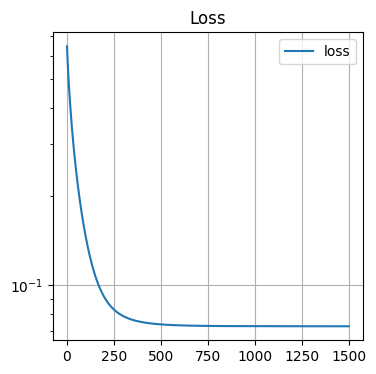

data type: synth


100%|██████████| 1500/1500 [00:19<00:00, 76.35it/s]


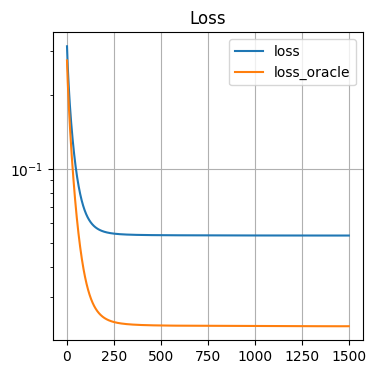

In [55]:
algorithm = "spectral_lms"
ALL_LOGS[algorithm] = {}

for data_type in DATA.keys():
    print("data type:", data_type)
    convolution, logs = fit_spectral_lms(**DATA[data_type], loss_type="spectral")
    ALL_LOGS[algorithm][data_type] = (convolution.cpu(), logs)

    _, ax = plt.subplots(figsize=(4, 4))

    ax.set_title("Loss")
    keys = ["loss"]
    if data_type == "synth":
        keys.append("loss_oracle")
    for key in keys:
        ax.plot([x[key] for x in logs], label=key)
    ax.grid()
    ax.legend()
    ax.set_yscale("log")

    plt.show()

    data = DATA[data_type]
    echo_est = convolution.apply(data["ref"])
    near_end_est = data["mic"] - echo_est

    root_out = os.path.join(ROOT_OUT, f"{algorithm}_{data_type}")
    os.makedirs(root_out, exist_ok=True)

    sf.write(os.path.join(root_out, "near_end_est.wav"),  near_end_est, SR)
    for key in ["mic", "ref"]:
        sf.write(os.path.join(root_out, f"{key}.wav"),  data[key], SR)

Let's compare the MSE values for both of the methods. We'll use the synthetic data to access the oracle MSE:

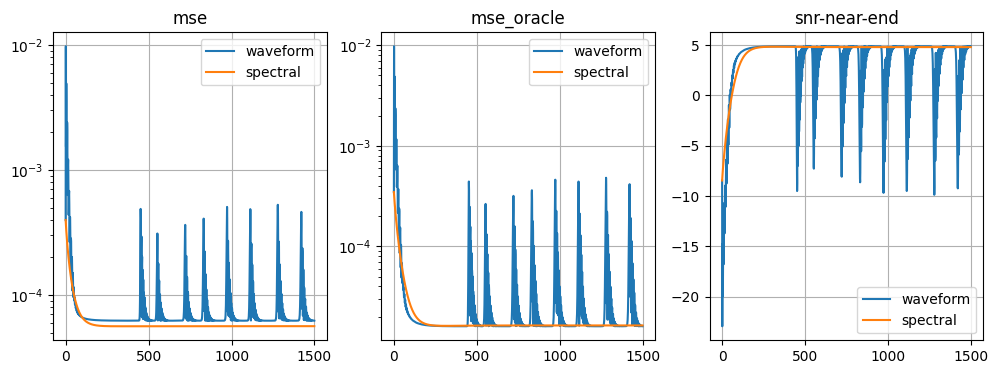

MSE oracle min values:
Waveform LMS: 1.6056479580583982e-05 , Spectral LMS: 1.6215644791373052e-05


In [56]:
data_type = "synth"
mse_waveform = [x["loss"] for x in ALL_LOGS["waveform_lms"][data_type][1]]
mse_oracle_waveform = [x["loss_oracle"] for x in ALL_LOGS["waveform_lms"][data_type][1]]
near_end_snr_waveform = [x["snr_near"] for x in ALL_LOGS["waveform_lms"][data_type][1]]

mse_spectral = [x["mse"] for x in ALL_LOGS["spectral_lms"][data_type][1]]
mse_oracle_spectral = [x["mse_oracle"] for x in ALL_LOGS["spectral_lms"][data_type][1]]
near_end_snr_spectral = [x["snr_near"] for x in ALL_LOGS["spectral_lms"][data_type][1]]

_, axes = plt.subplots(figsize=(12, 4), ncols=3)

ax = axes[0]
ax.set_title("mse")
ax.plot(mse_waveform, label="waveform")
ax.plot(mse_spectral, label="spectral")
ax.set_yscale("log")
ax.grid()
ax.legend()

ax = axes[1]
ax.set_title("mse_oracle")
ax.plot(mse_oracle_waveform, label="waveform")
ax.plot(mse_oracle_spectral, label="spectral")
ax.set_yscale("log")
ax.grid()
ax.legend()

ax = axes[2]
ax.set_title("snr-near-end")
ax.plot(near_end_snr_waveform, label="waveform")
ax.plot(near_end_snr_spectral, label="spectral")
ax.grid()
ax.legend()
plt.show()


print("MSE oracle min values:")
print("Waveform LMS:", min(mse_oracle_waveform), ", Spectral LMS:", min(mse_oracle_spectral))

**Question:** what can you observe from your implementation of waveform-domain and time-frequency domain LMS? Please, comment on the speed, stability and quality of the algorithms. It may be helpful to listen to the outputs to make up a subjective opinion. You may want to fit time-frequency LMS with waveform domain loss.

**YOUR ANSWER HERE**

What's the theory behind Time-frequency domain LMS? Let's get down to it.

### Time-Frequency Domain Adaptive LMS / NLMS \[0.5 pt\]

The adaptive LMS algorithm can also be applied in the time-frequency domain, i.e., to time-frequency (STFT) representations of the signals.

- $Y = STFT(y)$: complex spectrogram of the microphone signal
- $S = STFT(s)$: complex spectrogram of the reference (speaker) signal

Let $Y_{f, \tau}$ and $S_{f, \tau}$ denote the complex values at frequency bin $f$ and time frame $\tau$.

For each frequency bin $f$, we estimate a filter $h_f$ of length $L$ that models the echo path in the complex spectral domain.

#### Adaptive LMS in the Spectral Domain

At each time frame $\tau$ and frequency $f$:

- Form the input vector for the filter at frequency $f$:
  $$
  \mathbf{s}_{f, \tau} = [S_{f, \tau},\; S_{f, \tau-1},\; \ldots,\; S_{f, \tau-L+1}]^\top
  $$
  (zero pad if needed).
- Estimated echo:
  $$
  \hat E_{f, \tau} = h_f^\mathrm{H}  \mathbf{s}_{f, \tau}
  $$
  where $h_f$ is the current filter for frequency $f$, and ${}^\mathrm{H}$ denotes Hermitian (complex conjugate transpose).
- Error:
  $$
  e_{f, \tau} = Y_{f, \tau} - \hat E_{f, \tau}
  $$
- LMS update for $h_f$:
  $$
  h_f \leftarrow h_f + \eta\, e_{f, \tau}^*\, \mathbf{s}_{f, \tau}
  $$
  where $e_{f, \tau}^*$ denotes the complex conjugate, and $\eta$ is the learning rate. You can calculate the gradient yourself, and at the same time make sure that I'm not mistaken.

#### NLMS (Normalized LMS) in the Spectral Domain

To improve convergence, step size can be normalized by the input energy:
$$
h_f \leftarrow h_f + \frac{\eta}{\|\mathbf{s}_{f, \tau}\|^2 + \epsilon}\; e_{f, \tau}^*\, \mathbf{s}_{f, \tau}
$$
where $\epsilon$ is a small constant to avoid division by zero.



In [100]:
def fit_spectral_streaming_lms(
    mic: np.ndarray,
    ref: np.ndarray,
    echo: np.ndarray = None,
    near_end: np.ndarray = None,
    mu: float = 1e-3,
    fft_size: int = 2048,
    win_length: int = 2048,
    hop_length: int = 512,
    history_frames: int = 1,
    device: str = "cuda" if torch.cuda.is_available() else "cpu",
    verbose: bool = False,
    use_spectral_plots: bool = False,
    fs: int = 16000,
    normalize = False
) -> Dict[str, Union[np.ndarray, Dict[str, float], List[float]]]:
    """
    Fits time-frequency-domain LMS for mic and ref and calculates metrics during training.

    Echo and near_end are unavailable in practice and should only be used for metrics calculation
    If not provided, echo will be replaced by mic, near_end will be replaced by zeros
    """
    if echo is None:
        echo = mic
    if near_end is None:
        near_end = np.zeros_like(mic)

    original_length = len(mic)
    padding_length = win_length + hop_length

    mic_padded = np.pad(mic, (0, padding_length))
    ref_padded = np.pad(ref, (0, padding_length))
    echo_padded = np.pad(echo, (0, padding_length))
    near_end_padded = np.pad(near_end, (0, padding_length))

    mic_pt = torch.tensor(mic_padded, dtype=torch.float32, device=device)
    ref_pt = torch.tensor(ref_padded, dtype=torch.float32, device=device)
    echo_pt = torch.tensor(echo_padded, dtype=torch.float32, device=device)
    near_end_pt = torch.tensor(near_end_padded, dtype=torch.float32, device=device)

    window = torch.hann_window(win_length, device=device)

    n_freqs = win_length // 2 + 1

    mic_stft = torch.stft(mic_pt, n_fft=fft_size, hop_length=hop_length,
                          win_length=win_length, window=window,
                          return_complex=True, normalized=False, onesided=True)

    ref_stft = torch.stft(ref_pt, n_fft=fft_size, hop_length=hop_length,
                          win_length=win_length, window=window,
                          return_complex=True, normalized=False, onesided=True)

    num_freq_bins = mic_stft.shape[0]
    num_frames = mic_stft.shape[1]

    assert num_freq_bins == n_freqs, f"Expected {n_freqs} frequency bins, but got {num_freq_bins}"

    # Init filter for each freq. bin
    filter_weights = torch.zeros((num_freq_bins, history_frames),
                                dtype=torch.complex64, device=device)

    output_stft = torch.zeros_like(mic_stft)
    echo_estimate_stft = torch.zeros_like(mic_stft)

    ref_history = torch.zeros((num_freq_bins, history_frames),
                             dtype=torch.complex64, device=device)

    for frame_idx in tqdm(range(num_frames), disable=not verbose):
        ref_history = torch.roll(ref_history, shifts=-1, dims=1)
        ref_history[:, 0] = ref_stft[:, frame_idx]

        # YOUR CODE HERE

        echo_hat = torch.sum(torch.conj(filter_weights) * ref_history, dim=1)
        echo_estimate_stft[:, frame_idx] = echo_hat
        error = mic_stft[:, frame_idx] - echo_hat
        output_stft[:, frame_idx] = error
        
        if normalize:
            norm = torch.sum(torch.abs(ref_history) ** 2, dim=1) + 1e-8
            filter_weights = filter_weights + ((mu / norm)[:, None] * torch.conj(error)[:, None] * ref_history)
        else:
            filter_weights = filter_weights + mu * torch.conj(error)[:, None] * ref_history
        # YOUR CODE HERE

    output_signal = torch.istft(output_stft, n_fft=fft_size,
                                hop_length=hop_length, win_length=win_length,
                                window=window)

    echo_estimate = torch.istft(echo_estimate_stft, n_fft=fft_size,
                                hop_length=hop_length, win_length=win_length,
                                window=window)

    output_signal = output_signal[:original_length]
    echo_estimate = echo_estimate[:original_length]

    output_np = output_signal.cpu().numpy()
    echo_estimate_np = echo_estimate.cpu().numpy()

    if len(output_np) != len(mic) or len(echo_estimate_np) != len(echo):
        min_length = min(len(mic), len(output_np), len(echo), len(echo_estimate_np))

        mic_truncated = mic[:min_length]
        echo_truncated = echo[:min_length]
        near_end_truncated = near_end[:min_length]
        output_np_truncated = output_np[:min_length]
        echo_estimate_np_truncated = echo_estimate_np[:min_length]

        metrics = calculate_metrics(
            mic_truncated,
            echo_truncated,
            near_end_truncated,
            output_np_truncated,
            echo_estimate_np_truncated
        )
    else:
        metrics = calculate_metrics(mic, echo, near_end, output_np, echo_estimate_np)

    if verbose:
        min_length = min(len(mic), len(ref), len(near_end), len(echo), len(output_np), len(echo_estimate_np))
        plot_results(
            mic[:min_length],
            ref[:min_length],
            near_end[:min_length],
            echo[:min_length],
            output_np[:min_length],
            echo_estimate_np[:min_length],
            use_spectral=use_spectral_plots,
            fs=fs
        )

        if history_frames > 0:
            plt.figure(figsize=(15, 5 * min(history_frames, 3)))
            for h in range(min(history_frames, 6)):
                plt.subplot(min(history_frames, 3), 2, h+1)
                plt.plot(np.abs(filter_weights.cpu().numpy()[:, h]))
                plt.title(f'Magnitude response (history frame {h})')
                plt.xlabel('Frequency bin')
                plt.ylabel('Magnitude')
                plt.grid(True)
            plt.tight_layout()
            plt.show()

    freq_response = {
        "freqs": np.linspace(0, fs/2, n_freqs),
        "magnitude": np.abs(filter_weights[:, 0].cpu().numpy()),
        "phase": np.angle(filter_weights[:, 0].cpu().numpy())
    }

    return {
        "near_end_est": output_np,
        "echo_est": echo_estimate_np,
        "metrics": metrics,
        "filter_weights": filter_weights.cpu().numpy(),
        "freq_response": freq_response
    }


100%|██████████| 224/224 [00:00<00:00, 7355.32it/s]

mic (echo + speech):


ref (far end):


near end


echo


near end est.


echo est


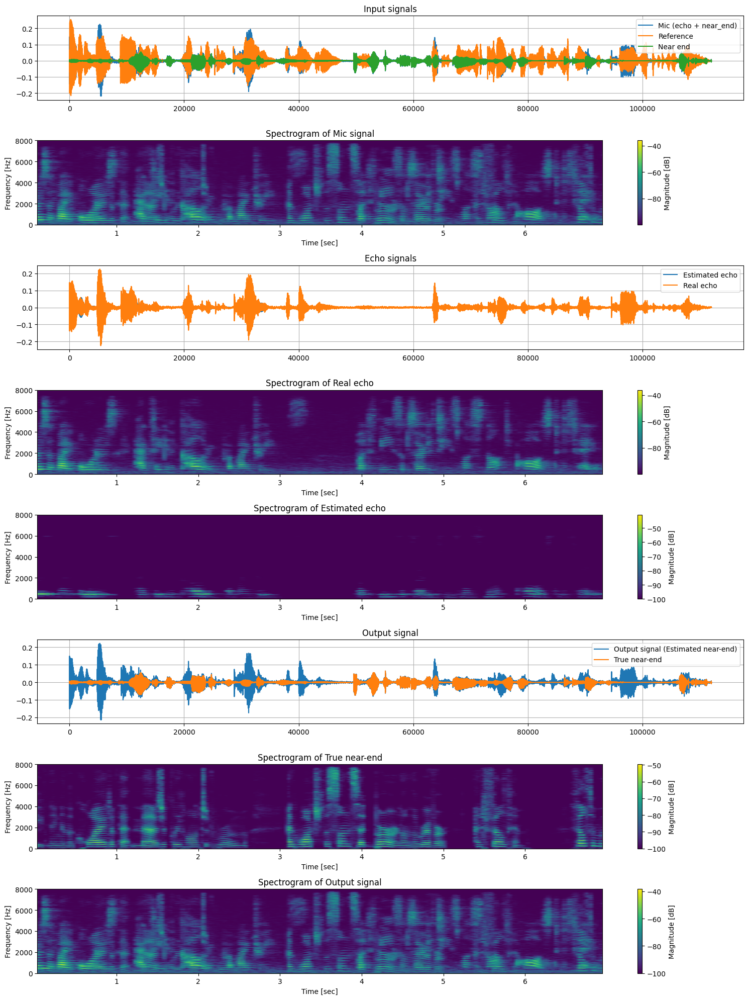

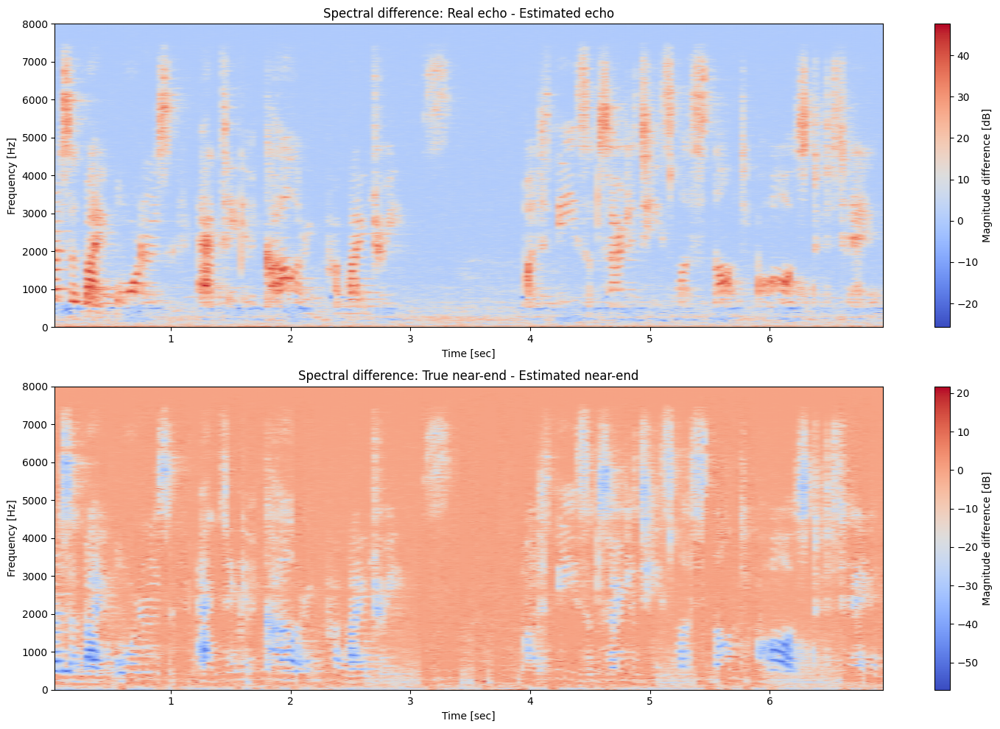

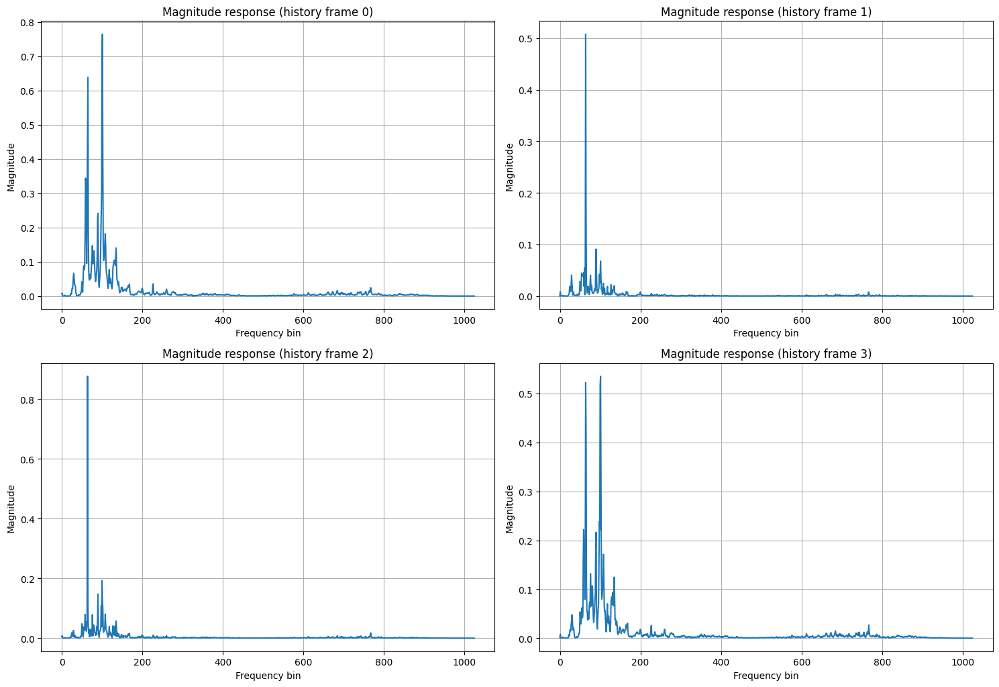

ERLE: 1.13 dB
SNR: -7.33 dB
Misalignment: -1.13 dB


In [101]:
adapt_vals_spectral = fit_spectral_streaming_lms(
    history_frames=4,
    mu=0.00043,
    verbose=True,
    use_spectral_plots=True,
    hop_length=512,
    win_length=2048,
    normalize=False,
    **DATA["synth"]
)

# Try your own params
metrics_spectral = adapt_vals_spectral["metrics"]
print(f"ERLE: {metrics_spectral['ERLE']:.2f} dB")
print(f"SNR: {metrics_spectral['SNR']:.2f} dB")
print(f"Misalignment: {metrics_spectral['Misalignment']:.2f} dB")

100%|██████████| 447/447 [00:00<00:00, 6299.98it/s]

mic (echo + speech):


ref (far end):


near end


echo


near end est.


echo est


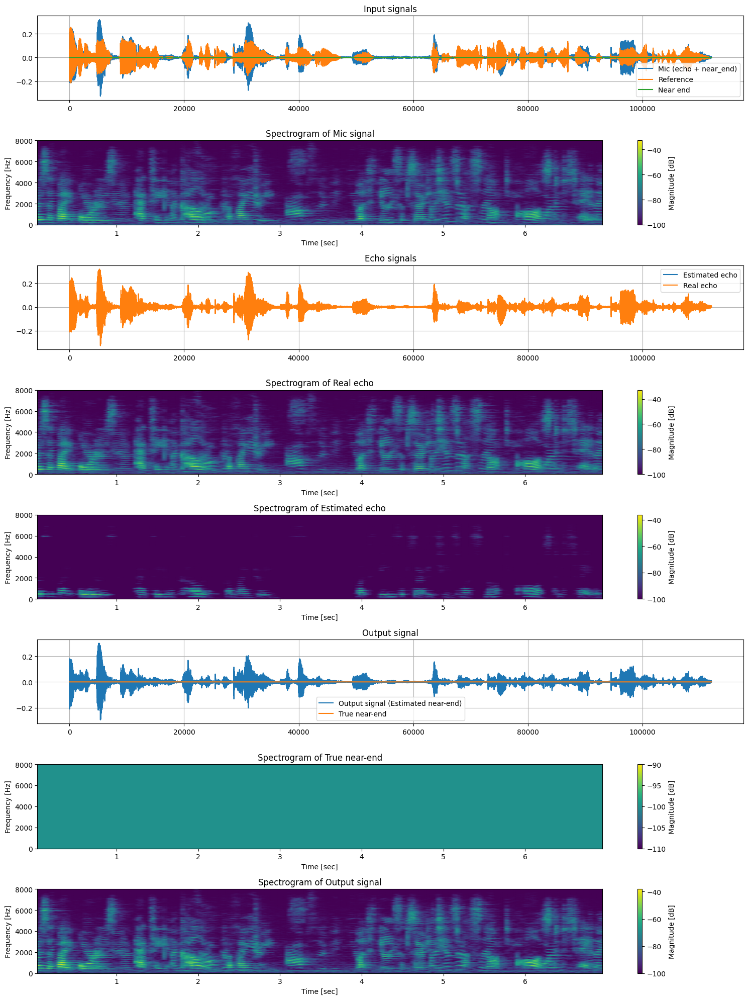

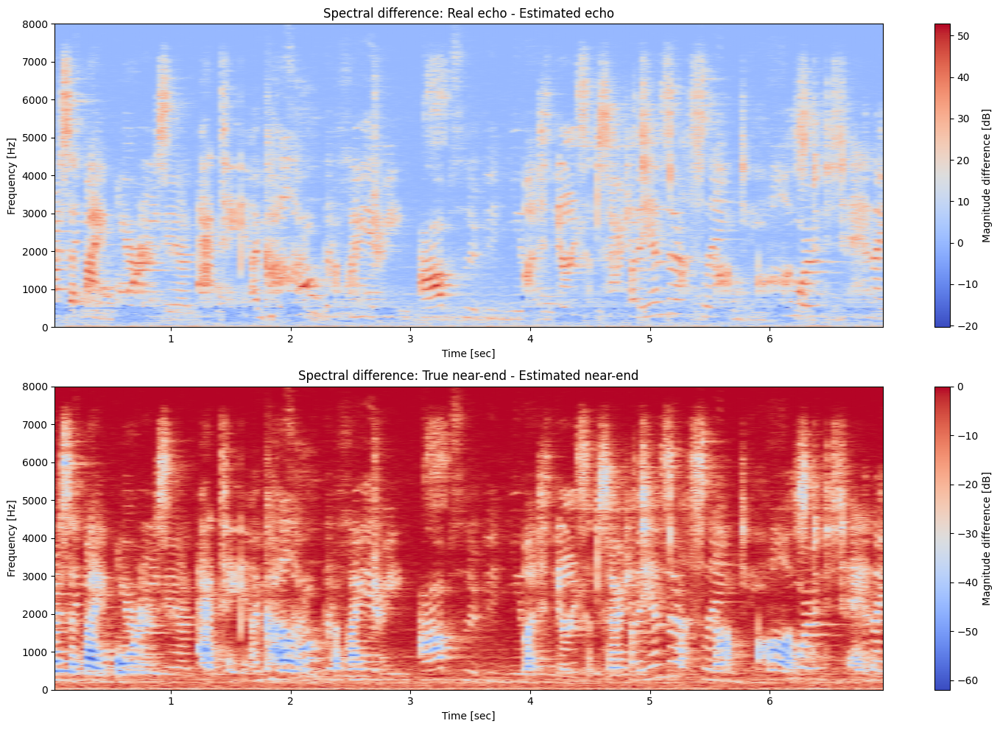

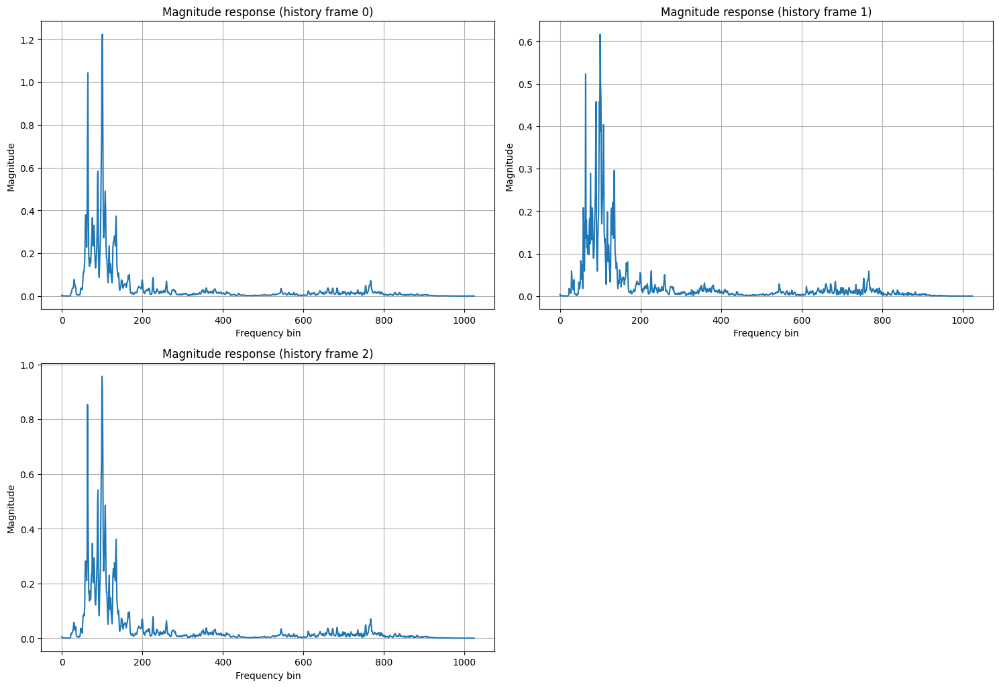

ERLE: 2.34 dB


In [102]:
adapt_vals_spectral = fit_spectral_streaming_lms(
    history_frames=3,
    mu=0.00043,
    verbose=True,
    use_spectral_plots=True,
    fft_size=2048,
    hop_length=256,
    win_length=2048,
    **DATA["real"]
)
metrics_spectral = adapt_vals_spectral["metrics"]
print(f"ERLE: {metrics_spectral['ERLE']:.2f} dB")

**Conclusion of using spectral methods:**

### Convolution in Time-Frequency (a.k.a. STFT) domain \[2 pts\]

We have seen that convolution in time domain can be replaced with multiplication in frequency (a.k.a. DFT) domain and it can save some computations. However, in order to get DFT from an input signal we need to access the whole signal which is only available for offline applications.

To make it online let's switch to time-frequency (a.k.a. STFT) domain.

**First, let's switch to block-wise processing.**

The idea is very simple: let's split the input signal into small windows (\~20-100 ms) and convolve them with the impulse response.

![title](assets/block_conv_operator_trunc_v1.png)

In the picture above we split the input signal into windows, convolve the windows with the impulse response and sum the resulting components. The result is equal to the convolution of the full signal with the impulse response.

It would be great to process the windows independently, but we can see that each window affects several future windows after convolution:

![title](assets/block_conv_final.png)

The output block $Y_t$ depends not only on the corresponding input block $X_t$ but also on the blocks $X_{t-1}$ and $X_{t-2}$ in this example.

**Let's describe it more formally.** Let $y = x * r$, let $w \in \mathbb N$ be the window size.

Window transform: $Y_t = (y_{wt}, y_{wt + 1}, ... ,y_{wt+w-1})$, $X_t = (x_{wt}, x_{wt + 1}, ... ,x_{wt + w -1})$, $R_k = (r_{wk}, r_{wk+1}, ..., r_{wk+w-1})$

It can be shown mathematically that:
$$\forall t ~~ Y_t = (X_t * R_0)[:w] + (X_{t-1} * R_0)[w:] + (X_{t-1} * R_1)[:w] + (X_{t-2} * R_1)[w:] + ... = \sum_{\tau + k=t}(X_\tau * R_k)[:w] + \sum_{\tau + k=t-1}(X_\tau * R_k)[w:],$$ where $[:w]$ stands for the first $w$ elements of a vector and $[w:]$ stands for the elements starting from $w$-th with one right-most element appended as zero to match the shapes. Let's look at this expression once again:

$$Y_t = \sum_{\tau + k=t}(X_\tau * R_k)[:w] + \sum_{\tau + k=t-1}(X_\tau * R_k)[w:]$$

Looks like a convolution with convolutions inside, doesn't it? The 2 sum terms correspond to the overlap-add procedure.

Here is what it looks like:
![title](assets/block_conv_ola_v3.png)

**Now we can formulate the stft-domain convolution algorithm:**

X = stft(x, win_size, n_fft=2 * win_size)

H = stft(h, win_size, n_fft=2 * win_size)

Y = convolve(X, H): frequency-wise convolution, i.e. convolution is done separately for each frequency

y = istft(y, 2 x win_size, n_fft=2 * win_size): note that the win-size is different from the original one

In [104]:
def stft_domain_convolution(x: torch.Tensor, h: torch.Tensor, win_size: int = 512) -> torch.Tensor:
    assert x.ndim == h.ndim == 1
    assert win_size % 2 == 0, win_size
    assert len(x) >= len(h), (x.shape, h.shape)
    size_final = len(x) + len(h) - 1
    x = F.pad(x, [0, -len(x) % win_size])  # making the length divisible by win_size
    if len(h) % win_size != 0:
        h = F.pad(h, [0, win_size - (len(h) % win_size)])

    x_wins = x.unfold(-1, win_size, win_size)  # window transform
    h_wins = h.unfold(-1, win_size, win_size)

    x_wins = F.pad(x_wins, [0, win_size]) # your code, zero padding: (n, win_size) -> (n, 2 x win_size)
    h_wins = F.pad(h_wins, [0, win_size]) # your code, zero padding: (n, win_size) -> (n, 2 x win_size)

    x_fft = torch.fft.rfft(x_wins).T  # (n_fft, n)
    h_fft = torch.fft.rfft(h_wins).T
    x_fft = F.pad(x_fft, [h_fft.shape[-1] - 1, h_fft.shape[-1] - 1])  # mode: full

    h_fft = torch.flip(h_fft, dims=[-1])  # for PyTorch or dot-product convolution

    # here you may choose either to do dot-product convolution
    # or to use F.conv1d for complex tensors

    # dot-product:
    convolved = []
    for x_start_idx in range(x_fft.shape[-1] - h_fft.shape[-1] + 1):
        block_x = x_fft[..., x_start_idx: x_start_idx + h_fft.shape[-1]]
        prod = (block_x * h_fft).sum(dim=-1)  # your code: specify the dimension
        convolved.append(prod)
    convolved = torch.stack(convolved, -1)

    # F.conv1d for complex tensors:
    convolved = (
        + F.conv1d(x_fft.real.unsqueeze(0), h_fft.real.unsqueeze(1), groups=x_fft.shape[0]).squeeze(0)
        - F.conv1d(x_fft.imag.unsqueeze(0), h_fft.imag.unsqueeze(1), groups=x_fft.shape[0]).squeeze(0)
        + 1j * F.conv1d(x_fft.real.unsqueeze(0), h_fft.imag.unsqueeze(1), groups=x_fft.shape[0]).squeeze(0)
        + 1j * F.conv1d(x_fft.imag.unsqueeze(0), h_fft.real.unsqueeze(1), groups=x_fft.shape[0]).squeeze(0)
    )

    windows_to_overlap = torch.fft.irfft(convolved.T)  # (n', 2 x win_size)

    # overlap-add operation
    out_chunks = []
    last_chunk = None
    for win in windows_to_overlap:
        if last_chunk is None:
            out_chunk = win[:win_size]
        else:
            out_chunk = last_chunk + win[:win_size]
        out_chunks.append(out_chunk)
        last_chunk = win[win_size:]
    out_chunks.append(last_chunk)
    result = torch.cat(out_chunks)
    result = result[:size_final]
    return result


torch.manual_seed(879235)
for _ in tqdm(range(20)):
    x = torch.rand(16_000)
    h = torch.rand(1000)
    win_size = 200
    out = stft_domain_convolution(x, h, win_size)
    ref = convolve_pt(x, h, mode="full")
    diff = out - ref
    assert diff.abs().max() < out.abs().mean() * 1e-5

print("You rock!")

100%|██████████| 20/20 [00:00<00:00, 38.86it/s]

You rock!


**Again, what we've just done:**

X = stft(x, win_size, n_fft=2 * win_size)

H = stft(h, win_size, n_fft=2 * win_size)

Y = convolve(X, H): frequency-wise convolution, i.e. convolution is done separately for each frequency

y = istft(y, 2 x win_size, n_fft=2 * win_size): note that the win-size is different from the original one

**It is not exactly what we did in frequency domain LMS:**
1. In freq-domain LMS we did stft with hann window and overlaps
2. We minized mean-squares in stft domain. This operation is pretty fair, as DFT is an isometrical transform (*)
3. We did not do the double-win-size trick in freq-domain LMS
4. Even if we did the double-win-size trick, it would be tricky to control that the time-frequency domain kernel we estimate can be transformed back to time domain

(*) What does "isometrical transform" mean? It preserves the distances, in our case the L2-norm. To be precise, in our situation, the norm is multiplied by $\sqrt{\text{win-size}}$:

In [105]:
size = 2048
x = torch.rand(size)
s = torch.fft.fft(x)

norm_wave = x.abs().square().mean().sqrt()
norm_spec = s.abs().square().mean().sqrt()

(norm_spec / norm_wave) ** 2, size

(tensor(2047.9996), 2048)

We said above: "it would be tricky to control that the time-frequency domain kernel we estimate can be transformed back to time domain". What does it mean?

STFT is an invertible operation with ISTFT being its inverse (given that hop size is sufficiently small and ignoring the edge effects which are perfectly handled by zero padding).

If we estimate a time-frequency domain kernel $H$, why don't we just take $h=ISTFT(H)$ as its time-domain counterpart?

It turns out that even though STFT is invertible, ISTFT is not. Tricky?

**Question:** provide an example of a complex spectrogram $S$, such that $STFT(ISTFT(S)) \neq S$ for STFT and ISTFT given in the code below.

**Tip:** set nfft > win_size. What is the probability that a random spectrogram satisfies the condition reqired?

In [106]:
stft_params = dict(win_length=512, n_fft=1024, hop_length=128)
stft = Spectrogram(**stft_params, power=None)
istft = InverseSpectrogram(**stft_params)

torch.manual_seed(682)
x = torch.rand(48_000)

s = stft(x)
x_restored = istft(s, length=len(x))

diff_wave = (x - x_restored).abs().mean()
print(f"diff wave: {diff_wave.item()}")
assert diff_wave < 1e-6

s_tricky = s

# your code: make up your s_tricky
s_tricky = torch.rand_like(s)

s_tricky_restored = stft(istft(s_tricky))

diff_spec = (s_tricky - s_tricky_restored).abs().mean()
norm_spec = (s_tricky).abs().mean()
diff_spec_rel = diff_spec.item() / norm_spec.item()

print(f"diff spec relative: {diff_spec_rel}")
assert diff_spec_rel > 0.5

diff wave: 3.806269788242389e-08
diff spec relative: 0.9919461628714382
